In [1]:
%matplotlib inline
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt

import tempmatch as tm
import obspy

from hydrophone_data_processing import load, preprocessing

import itertools

hydrophones = [0, 1, 2, 3, 4, 5]
hydrophone_pairs = [h for h in itertools.combinations(hydrophones, 2)]
hydrophone_pairs

[(0, 1),
 (0, 2),
 (0, 3),
 (0, 4),
 (0, 5),
 (1, 2),
 (1, 3),
 (1, 4),
 (1, 5),
 (2, 3),
 (2, 4),
 (2, 5),
 (3, 4),
 (3, 5),
 (4, 5)]

In [2]:
day138 = load.import_corrected_data_for_single_day(julian_day='138', year='2019', borehole='b')

In [3]:
day138.decimate(factor=10)
day138_original = day138.copy()
# https://docs.obspy.org/packages/autogen/obspy.signal.filter.bandpass.html#obspy.signal.filter.bandpass
# corners is the order
day138.filter(freqmin=5, freqmax=10, corners=4, type='bandpass', zerophase=True)
day138.detrend('demean')
preprocessing.square_stream(day138)

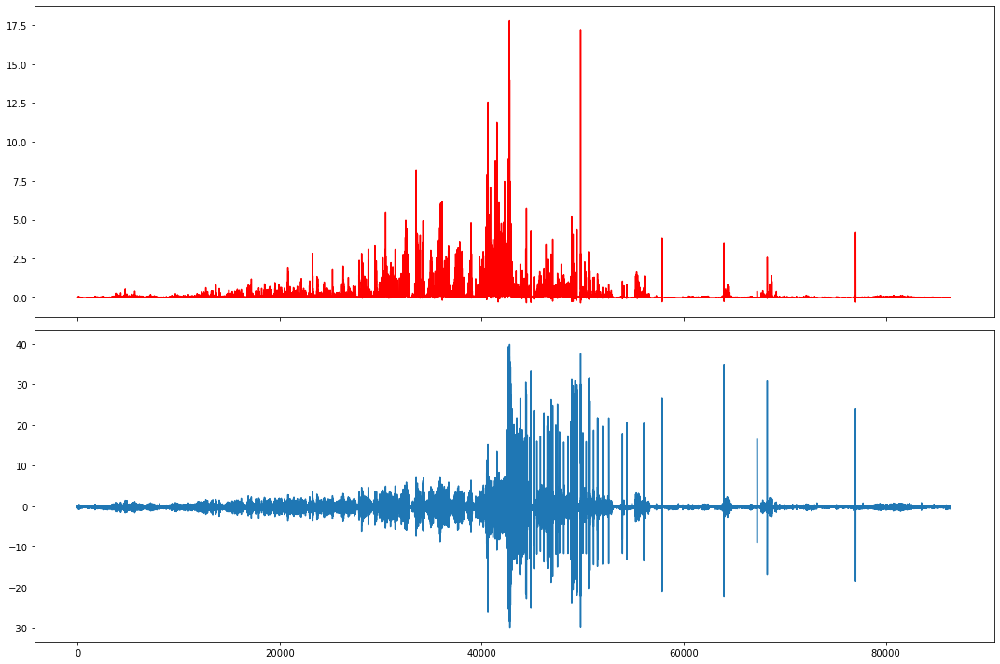

In [4]:
fig, ax = plt.subplots(2, 1, figsize=(15, 10), sharex=True)

data = day138.copy()
# data.filter(type='lowpass', freq=0.01, zerophase=True)
data.filter(type='lowpass', freq=0.5, corners=4, zerophase=True)

ax[0].plot(data[0].times(), data[0].data, color='red')
ax[1].plot(day138_original[0].times(), day138_original[0].data)

fig.tight_layout()

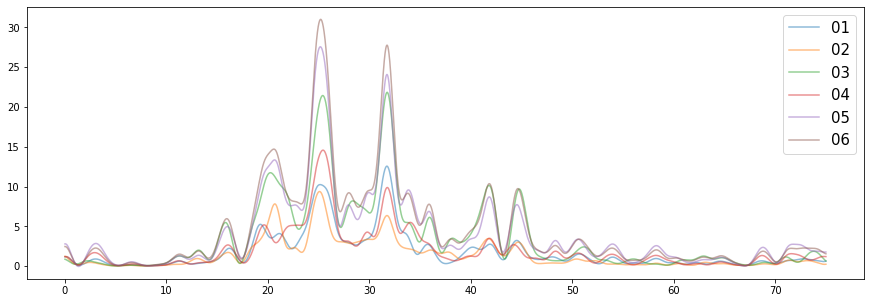

In [5]:
littlebits = data.slice(starttime=obspy.UTCDateTime('2019-05-18T11:16:30'), endtime=obspy.UTCDateTime('2019-05-18T11:17:45'))

fig, ax = plt.subplots(figsize=(15, 5))

for tr in littlebits:
    # x = tr.times('utcdatetime')
    x = tr.times()
    y = tr.data
    ax.plot(x, y, label=tr.stats.location, alpha=0.5,)
ax.legend(fontsize=15)

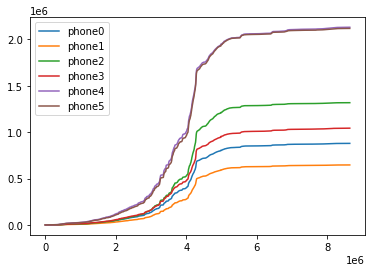

In [6]:
for n in [0, 1, 2, 3, 4, 5]:
    plt.plot(data[n].data.cumsum(), label='phone{n}'.format(n=n))
# plt.plot(data[5].data.cumsum())
plt.legend()

'0.001'

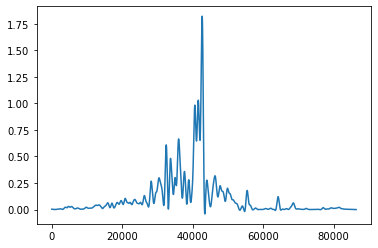

In [33]:
plt.plot(data[0].times(), data[0].data)
str(freq)

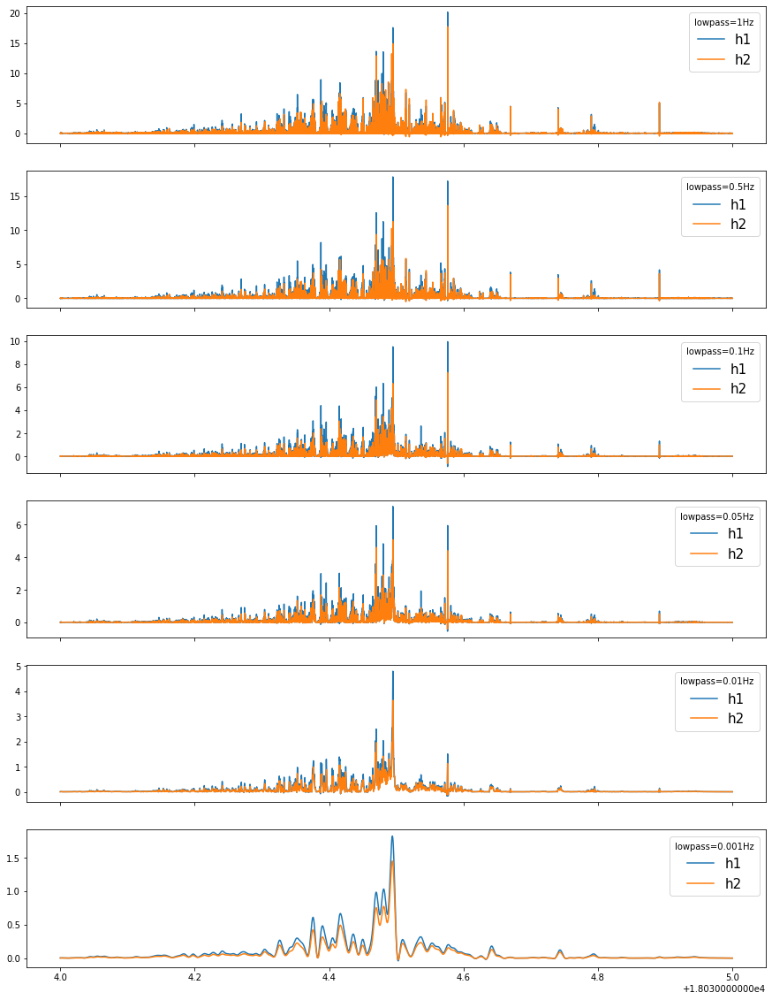

In [45]:
# fig, ax = plt.subplots(figsize=(15, 5))
fig, ax = plt.subplots(6, 1, figsize=(15, 20), sharex=True)

freqs = [1, 0.5, 0.1, 0.05, 0.01, 0.001]
for n, freq in enumerate(freqs):
    data = day138.copy()
    data.filter('lowpass', freq=freq, zerophase=True)
    ax[n].plot(data[0].times('matplotlib'), data[0].data, label='h1')
    ax[n].plot(data[1].times('matplotlib'), data[1].data, label='h2')
    ax[n].legend(fontsize=15, title='lowpass={f}Hz'.format(f=str(freq)))
    # ax[n].text(s='lowpass={}Hz'.format(str(freq)), x=1, y=5, fontsize=15)
    
# fig.tight_layout()

In [46]:
'lowpass={f}hz'.format(f=freq)

'lowpass=0.001hz'

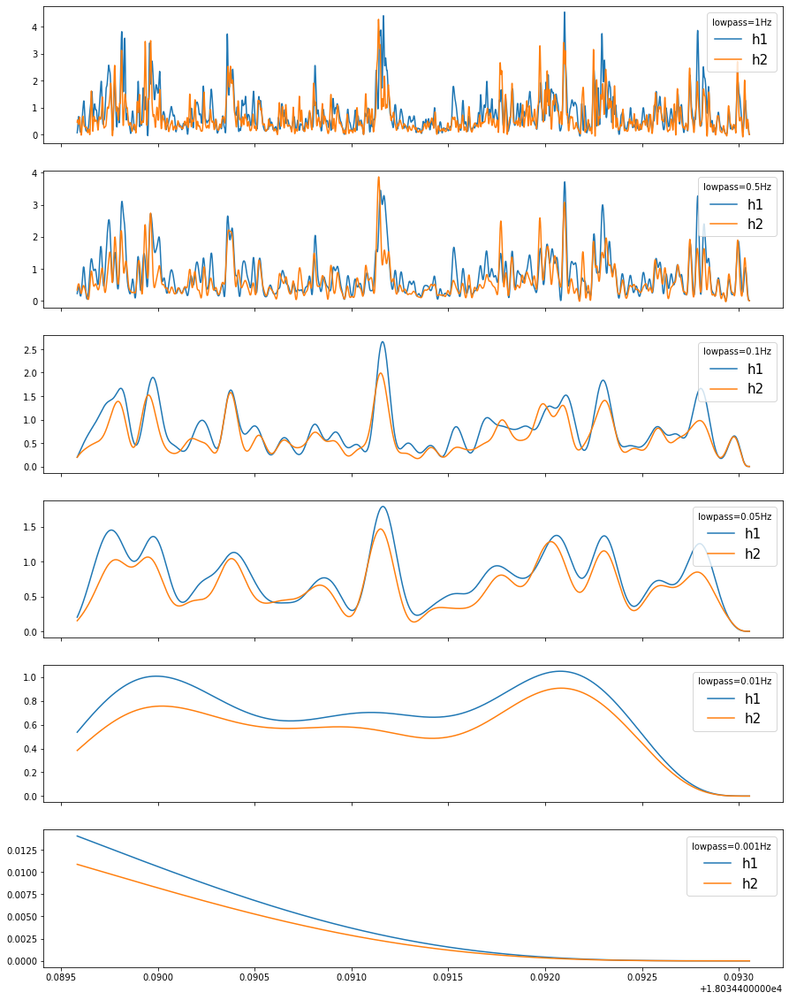

In [47]:
fig, ax = plt.subplots(6, 1, figsize=(15, 20), sharex=Tru
    data = day138.copy()
    data = data.slice(starttime=obspy.UTCDateTime('2019-05-18T11:45:00')
               , endtime=obspy.UTCDateTime('2019-05-18T11:50:00'))
    data.filter('lowpass', freq=freq, zerophase=True)
    ax[n].plot(data[0].times('matplotlib'), data[0].data, label='h1')
    ax[n].plot(data[1].times('matplotlib'), data[1].data, label='h2')
    ax[n].legend(fontsize=15, title='lowpass={f}Hz'.format(f=str(freq)))
    # ax[n].text(s='lowpass={f}Hz, zoom='.format(f=freq), x=1, y=5, fontsize=15)
    
# fig.tight_layout()

In [80]:
# cc_df = pd.DataFrame()

# # window_length = 5*60
# window_length = 1*60

# data = day138.copy()
# data.filter('lowpass', freq=0.1)
# # day138_windows = day138.copy().filter('lowpass', freq=0.01).slide(window_length=5*60.0, step=5*60.0,)
# # day138_windows = day138.copy().filter('lowpass', freq=0.01).slide(window_length=window_length, step=window_length,)
# day138_windows = data.copy().slide(window_length=window_length, step=window_length,)

# n = -1
# for window in day138_windows:
#     # print(window[0].stats)
#     # print(window)
#     n += 1
#     for pair in hydrophone_pairs:
#         h1, h2 = pair
#         cc = obspy.signal.cross_correlation.correlate(a=window[h1]
#                                                       , b=window[h2]
#                                                       , shift=100*5
#                                                       # , shift=100*10
#                                                       , demean=True
#                                                       , normalize=False)
#         cc_norm = obspy.signal.cross_correlation.correlate(a=window[h1]
#                                                       , b=window[h2]
#                                                       , shift=100*5
#                                                       , demean=True
#                                                       , normalize=True)

#         window_df = pd.DataFrame(
#             {
#                 'window_index':[n,]
#                 ,'h1_index':(h1,) # first hydrophone index used for cross correlation
#                 , 'h2_index':(h2,) # second hydrophone index used for cross correlation
#                 ,'cross_correlation_max':[cc.max(),]
#                 ,'cross_correlation_index':[np.argmax(cc),]
#                 ,'sample_rate':[window[0].stats.sampling_rate,]
#                 ,'window_starttime':[window[0].stats.starttime,]
#                 ,'window_endtime':[window[0].stats.endtime]
#                 ,'lagtime_seconds':((np.argmax(cc)-500)*1/100.,)
#                 ,'cc_estimator':(cc,)
#                 ,'cc_estimator_normed':(cc_norm,)
#                 ,'cc_normed_max':(cc_norm.max(),)
#                 ,'cc_normed_idx':(np.argmax(cc_norm),)
#                 ,'normed_lagtime':((np.argmax(cc_norm)-500)/100.,)
#             }
#         )
#         cc_df = pd.concat([cc_df, window_df])
# cc_df.reset_index(inplace=True)
# cc_df.head()

,index,window_index,h1_index,h2_index,cross_correlation_max,cross_correlation_index,sample_rate,window_starttime,window_endtime,lagtime_seconds,cc_estimator,cc_estimator_normed,cc_normed_max,cc_normed_idx,normed_lagtime
0,0,0,0,1,0.143312,431,100.0,2019-05-18T00:00:02.907000Z,2019-05-18T00:01:01.537000Z,-0.69,"[0.0442641438838, 0.0444510940303, 0.044638482...","[0.270287684704, 0.271429248006, 0.27257348745...",0.875097,431,-0.69
1,0,0,0,2,0.239965,641,100.0,2019-05-18T00:00:02.907000Z,2019-05-18T00:01:01.537000Z,1.41,"[0.0437343287296, 0.0440275960985, 0.044321557...","[0.139382827166, 0.140317480474, 0.14125434435...",0.764776,641,1.41
2,0,0,0,3,0.489597,471,100.0,2019-05-18T00:00:02.907000Z,2019-05-18T00:01:01.537000Z,-0.29,"[0.226653736881, 0.227203664865, 0.22775372913...","[0.449161609226, 0.45025140612, 0.451341473093...",0.970239,471,-0.29
3,0,0,0,4,0.941094,503,100.0,2019-05-18T00:00:02.907000Z,2019-05-18T00:01:01.537000Z,0.03,"[0.371544742472, 0.37260500481, 0.373666100791...","[0.391127677211, 0.392243822585, 0.39336084554...",0.990696,503,0.03
4,0,0,0,5,0.777770,464,100.0,2019-05-18T00:00:02.907000Z,2019-05-18T00:01:01.537000Z,-0.36,"[0.316760482064, 0.317676879001, 0.3185941085,...","[0.401134927664, 0.402295422232, 0.40345697112...",0.984942,464,-0.36


In [93]:
freq_test = pd.DataFrame()

freqs = [1, 0.5, 0.1, 0.05, 0.01, 0.001]
for n, freq in enumerate(freqs):
    cc_df = pd.DataFrame()

    # window_length = 5*60
    window_length = 1*60

    data = day138.copy()
    data.filter('lowpass', freq=freq)
    day138_windows = data.copy().slide(window_length=window_length, step=window_length,)

    n = -1
    for window in day138_windows:

        n += 1
        for pair in hydrophone_pairs:
            h1, h2 = pair
            cc = obspy.signal.cross_correlation.correlate(a=window[h1]
                                                          , b=window[h2]
                                                          , shift=100*5
                                                          # , shift=100*10
                                                          , demean=True
                                                          , normalize=False)
            cc_norm = obspy.signal.cross_correlation.correlate(a=window[h1]
                                                          , b=window[h2]
                                                          , shift=100*5
                                                          , demean=True
                                                          , normalize=True)

            window_df = pd.DataFrame(
                {
                    'window_index':[n,]
                    ,'h1_index':(h1,) # first hydrophone index used for cross correlation
                    , 'h2_index':(h2,) # second hydrophone index used for cross correlation
                    ,'cross_correlation_max':[cc.max(),]
                    ,'cross_correlation_index':[np.argmax(cc),]
                    ,'sample_rate':[window[0].stats.sampling_rate,]
                    ,'window_starttime':[window[0].stats.starttime,]
                    ,'window_endtime':[window[0].stats.endtime]
                    ,'lagtime_seconds':((np.argmax(cc)-500)*1/100.,)
                    ,'cc_estimator':(cc,)
                    ,'cc_estimator_normed':(cc_norm,)
                    ,'cc_normed_max':(cc_norm.max(),)
                    ,'cc_normed_idx':(np.argmax(cc_norm),)
                    ,'normed_lagtime':((np.argmax(cc_norm)-500)/100.,)
                }
            )
            cc_df = pd.concat([cc_df, window_df])
    cc_df.reset_index(inplace=True)
    freq_test['ccmax-{f}hz'.format(f=freq)] = cc_df.cross_correlation_max
    freq_test['lagtime_seconds_{f}hz'.format(f=freq)] = cc_df.lagtime_seconds

In [94]:
freq_test.head()

,ccmax-1hz,lagtime_seconds_1hz,ccmax-0.5hz,lagtime_seconds_0.5hz,ccmax-0.1hz,lagtime_seconds_0.1hz,ccmax-0.05hz,lagtime_seconds_0.05hz,ccmax-0.01hz,lagtime_seconds_0.01hz,ccmax-0.001hz,lagtime_seconds_0.001hz
0,0.297772,-0.69,0.283743,-0.67,0.143312,-0.69,0.075143,-0.69,0.005641,-0.69,2.247677e-09,-0.69
1,0.356350,-0.47,0.357943,-0.09,0.239965,1.41,0.141635,-0.11,0.009818,-0.11,3.828335e-09,-0.11
2,0.905462,-0.27,0.872216,-0.21,0.489597,-0.29,0.173151,-0.29,0.010087,-0.29,4.173942e-09,-0.29
3,1.841823,0.01,1.762647,0.05,0.941094,0.03,0.352765,0.03,0.020945,0.03,8.391996e-09,0.03
4,1.521405,-0.41,1.458422,-0.34,0.777770,-0.36,0.315332,-0.36,0.019858,-0.36,8.067867e-09,-0.36


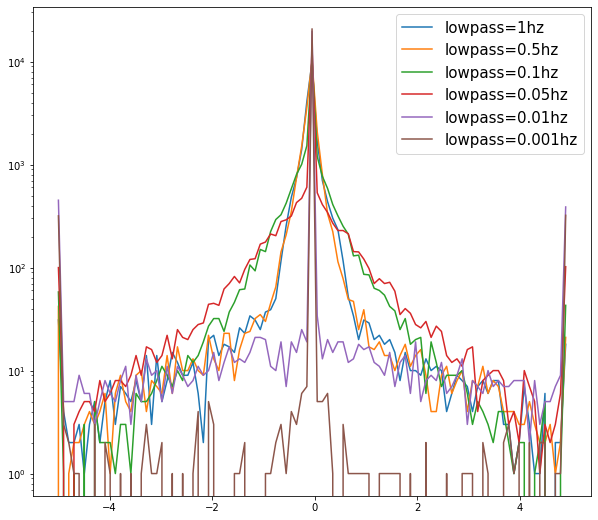

In [102]:
freq_test.columns

fig, ax = plt.subplots(figsize=(10, 9))

lagtimes = ['lagtime_seconds_1hz', 'lagtime_seconds_0.5hz', 'lagtime_seconds_0.1hz',
       'lagtime_seconds_0.05hz', 'lagtime_seconds_0.01hz', 'lagtime_seconds_0.001hz']
for lag in lagtimes:
    # ax.plot(freq_test[lag])
    h, e = np.histogram(freq_test[lag].values, bins=np.linspace(-5, 5, 100))
    ax.plot(e[:-1], h, label='lowpass={f}'.format(f=lag.split('_')[-1]))
ax.set_yscale('log')
ax.legend(fontsize=15)

#higher lowpass means lower lag times

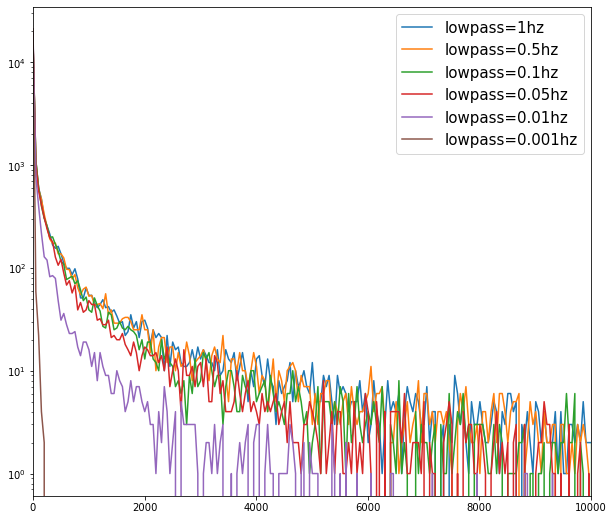

In [111]:
freq_test.columns

fig, ax = plt.subplots(figsize=(10, 9))

ccmaxs = ['ccmax-1hz', 'ccmax-0.5hz', 'ccmax-0.1hz',
       'ccmax-0.05hz', 'ccmax-0.01hz',
       'ccmax-0.001hz']

for cc in ccmaxs:
    h, e = np.histogram(freq_test[cc].values, bins=np.linspace(0, 50000, 1000))
    ax.plot(e[:-1], h, label='lowpass={f}'.format(f=cc.split('-')[-1]))
    
ax.legend(fontsize=15)
ax.set_xlim(0, 10000)
ax.set_yscale('log')

<AxesSubplot:>

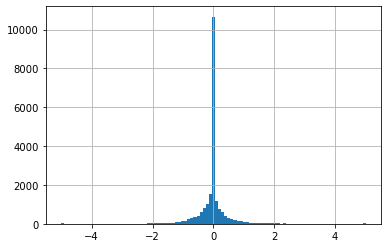

In [86]:
cc_df.normed_lagtime.hist(bins=np.linspace(-5, 5, 100))

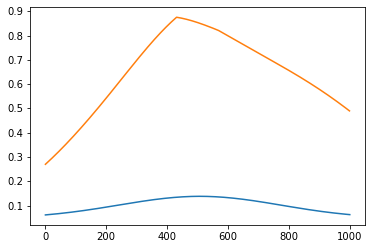

In [87]:
plt.plot(cc_df.cc_estimator[73])
plt.plot(cc_df.cc_estimator_normed[0])

In [10]:
# data.plot()

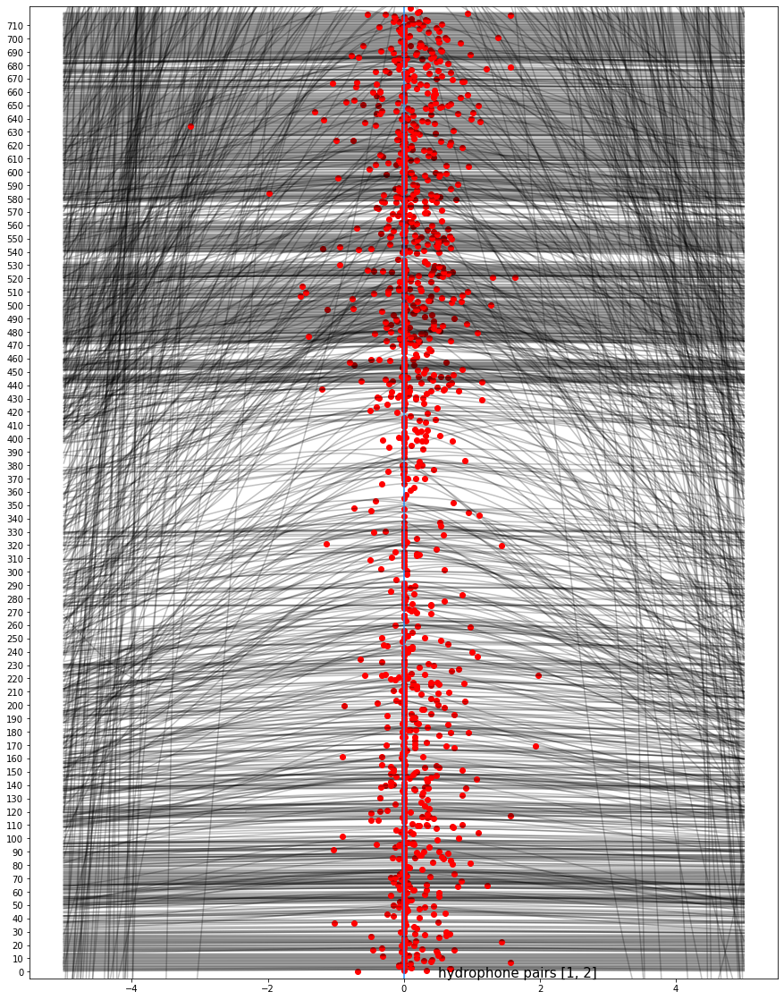

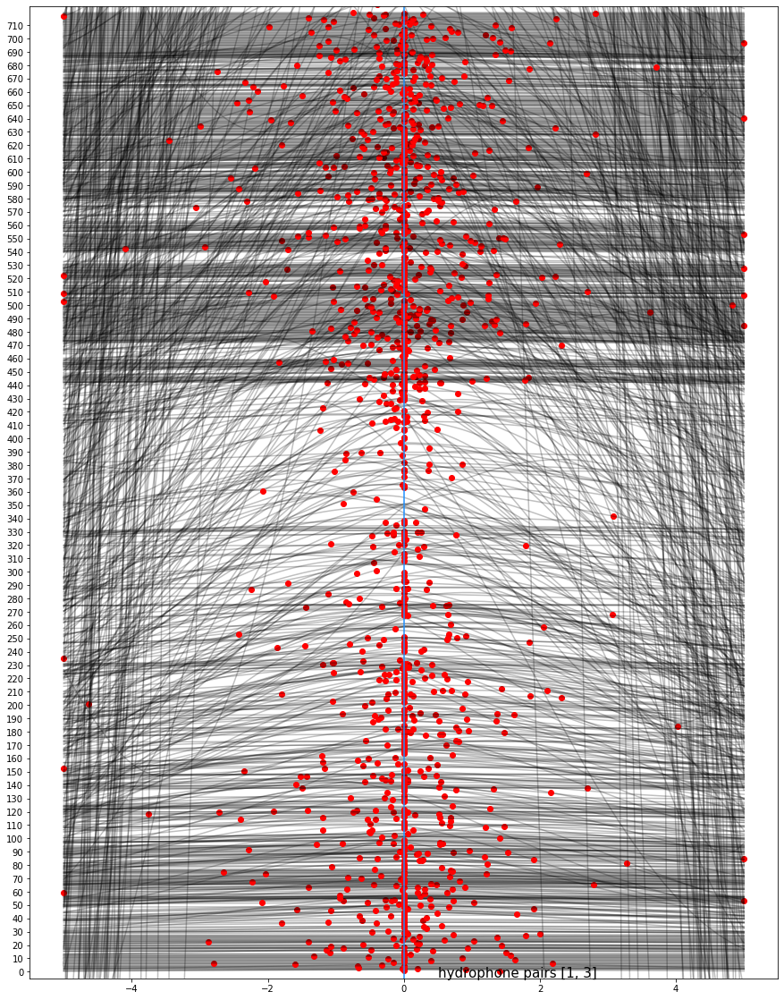

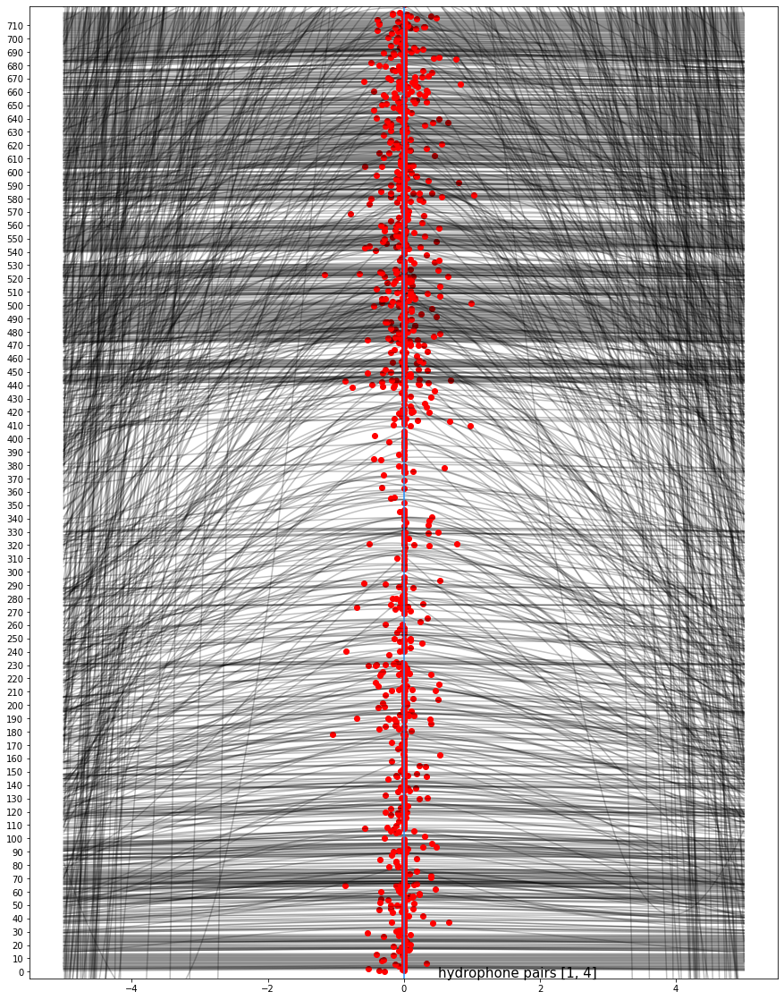

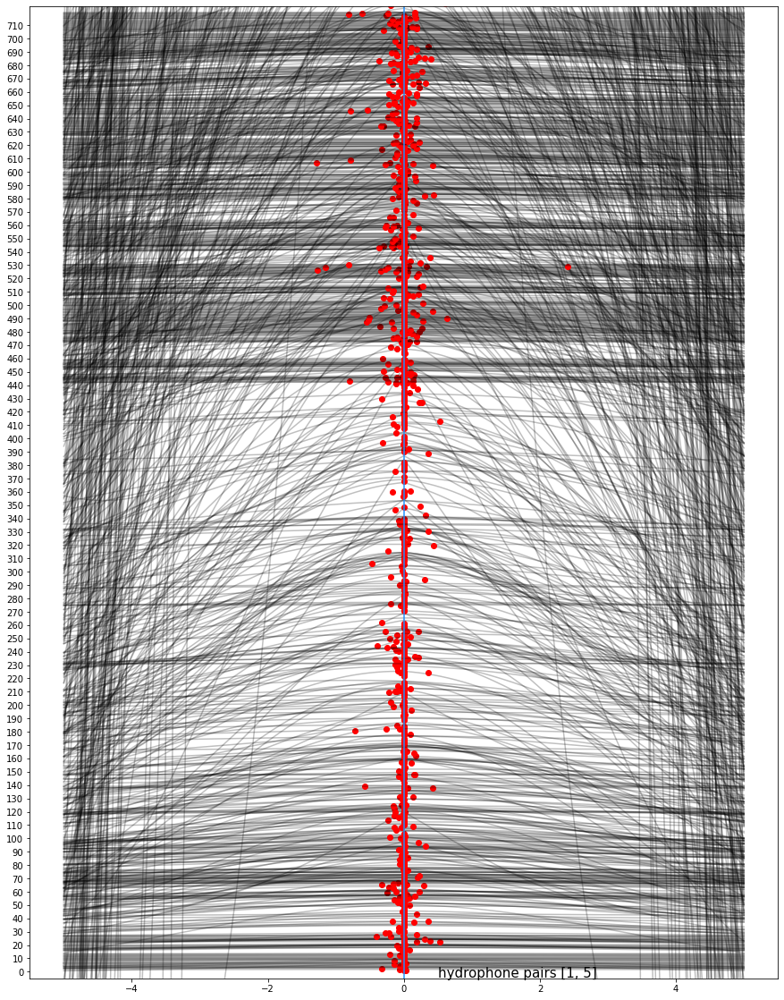

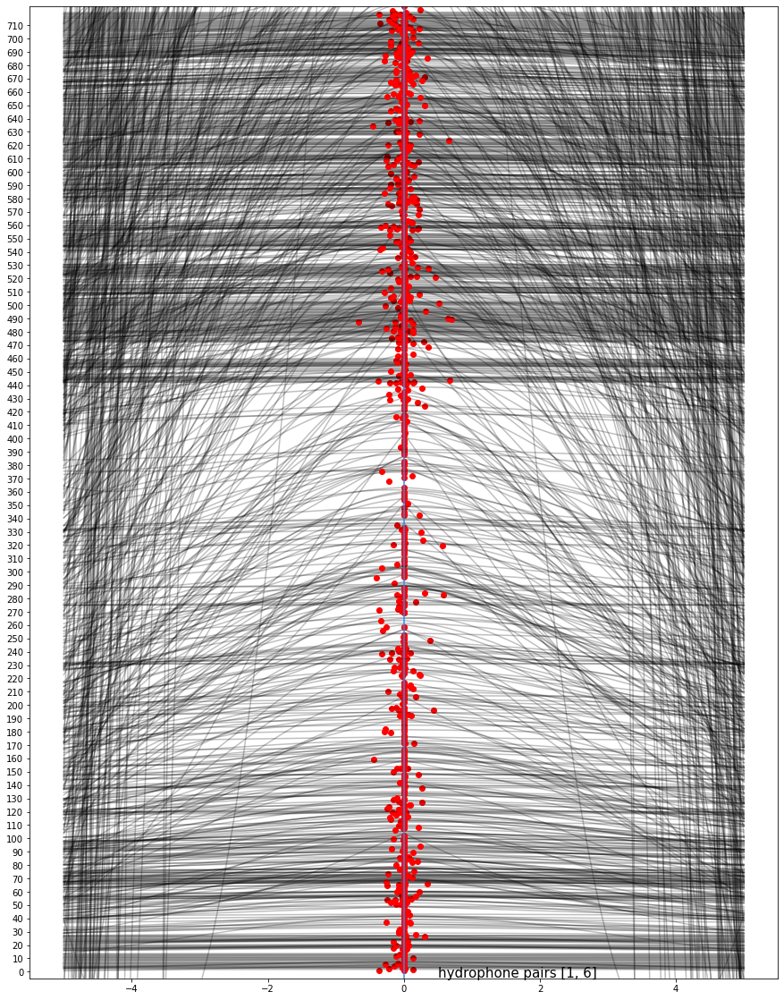

...

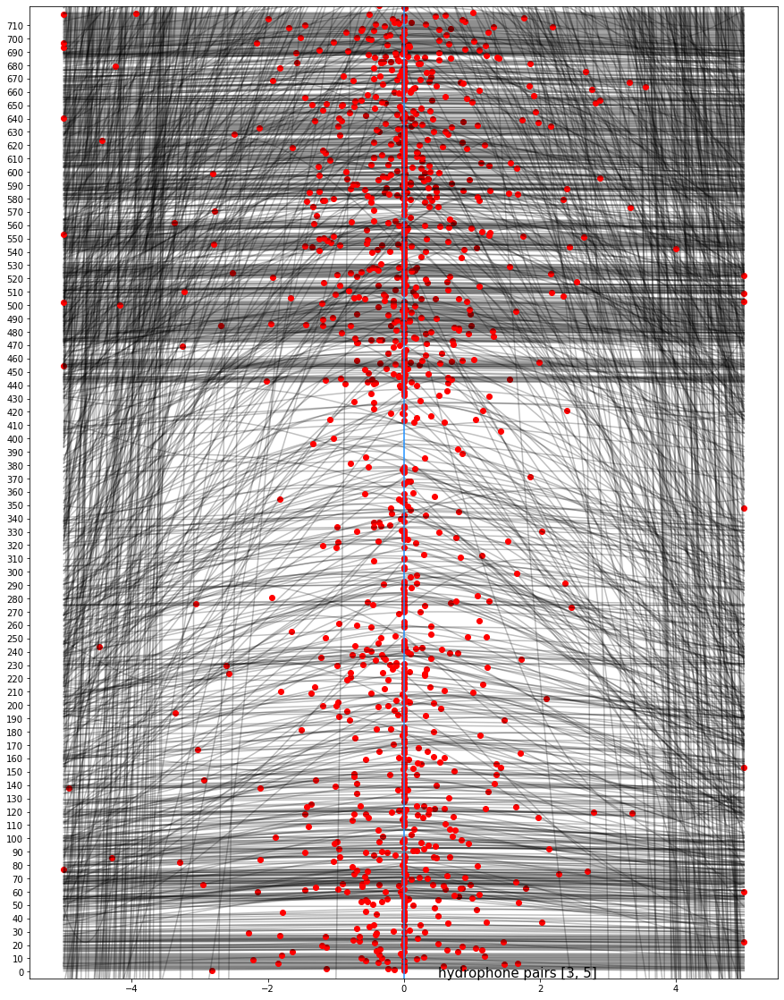

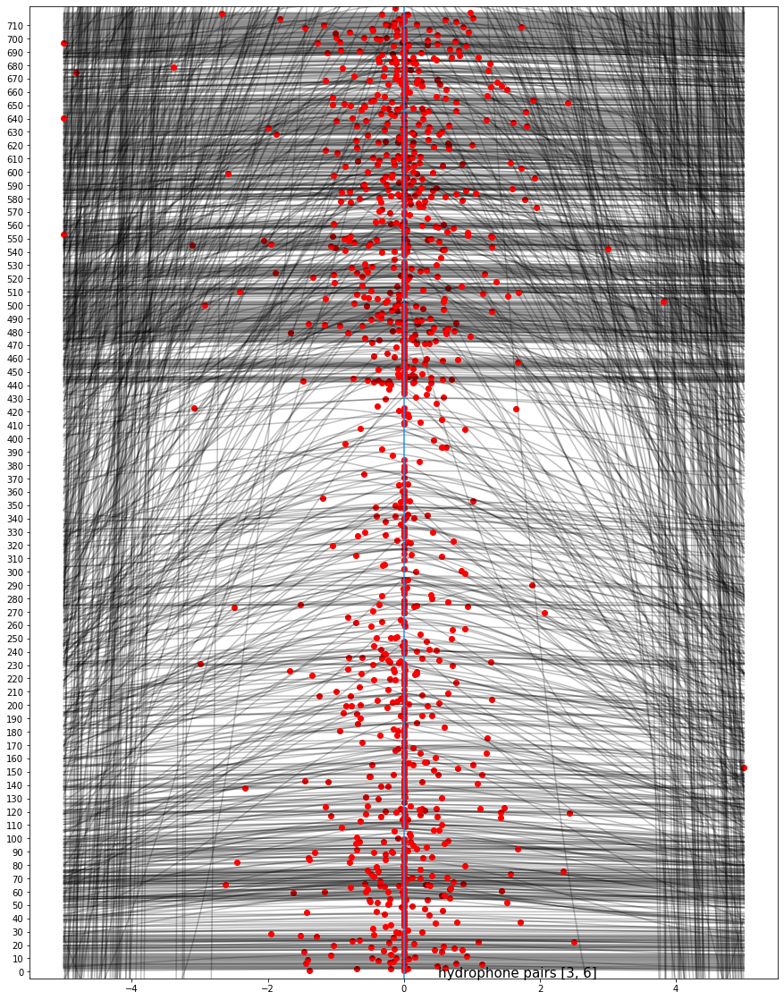

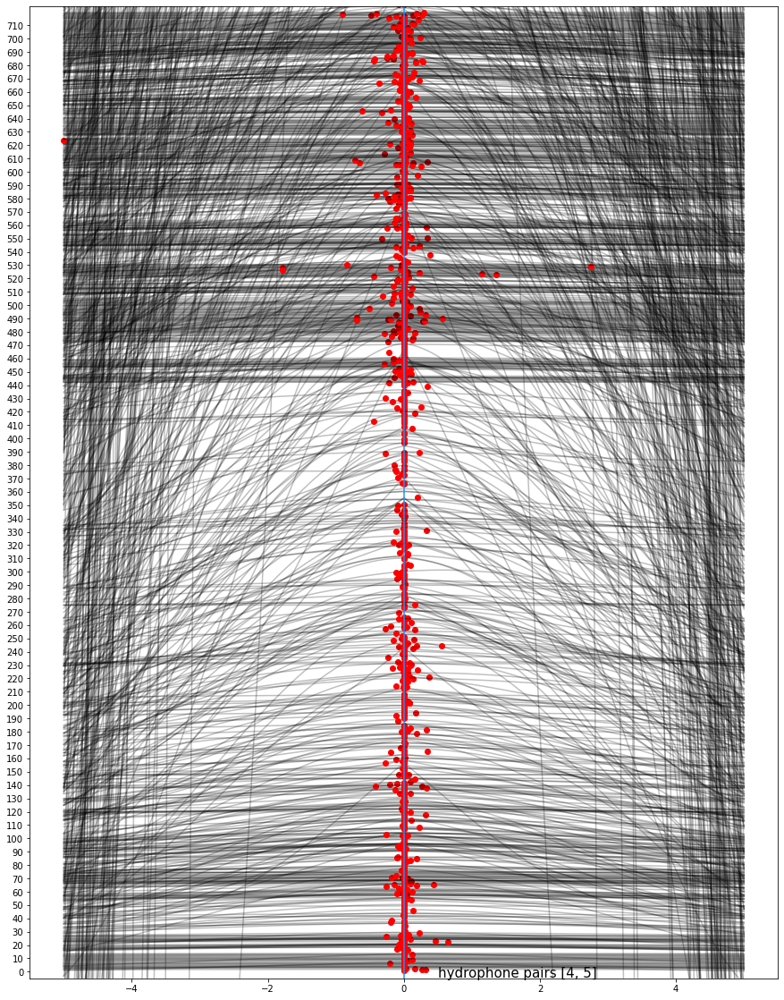

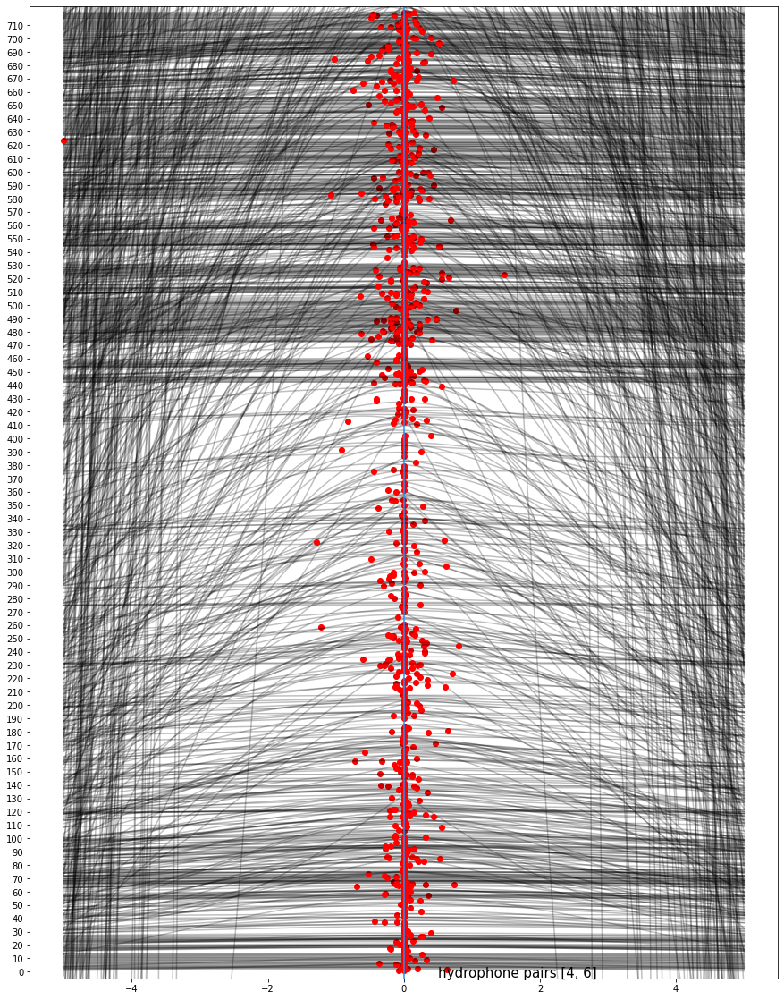

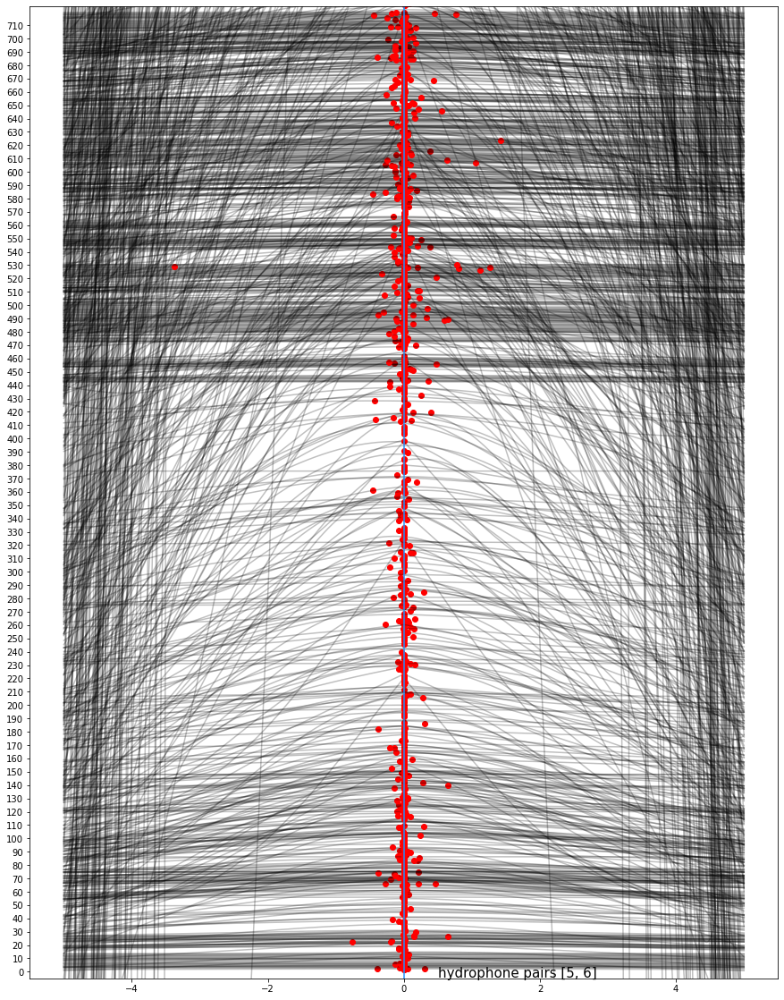

In [88]:
for pairs in hydrophone_pairs:
    fig, ax = plt.subplots(figsize=(15, 20))
    h1, h2 = pairs
    data = cc_df[(cc_df.h1_index==h1) & (cc_df.h2_index==h2)]

    for n, cc in enumerate(data.cc_estimator.values):
        n = n * 0.5
        x = np.linspace(-5, 5, cc.shape[0])
        ax.plot(x, (cc*10+n), color='black', alpha=0.25)
        ax.plot((x[np.argmax(cc)],), (cc.max()+n,), marker='o', color='red')

    ax.plot([0, 0], [-5, n+5], color='dodgerblue')
    ax.set_ylim(-5, n+5)
    ax.set_yticks(np.arange(0, n, 10))
    # ax.set_yticklabels(data.window_starttime[::19][:-1])
    # ax.set_xlim(-1, 1)
    
    ax.text(s='hydrophone pairs {pairs}'.format(pairs=str([p+1 for p in pairs]))
            ,x=0.5, y=-4, fontsize=15 )

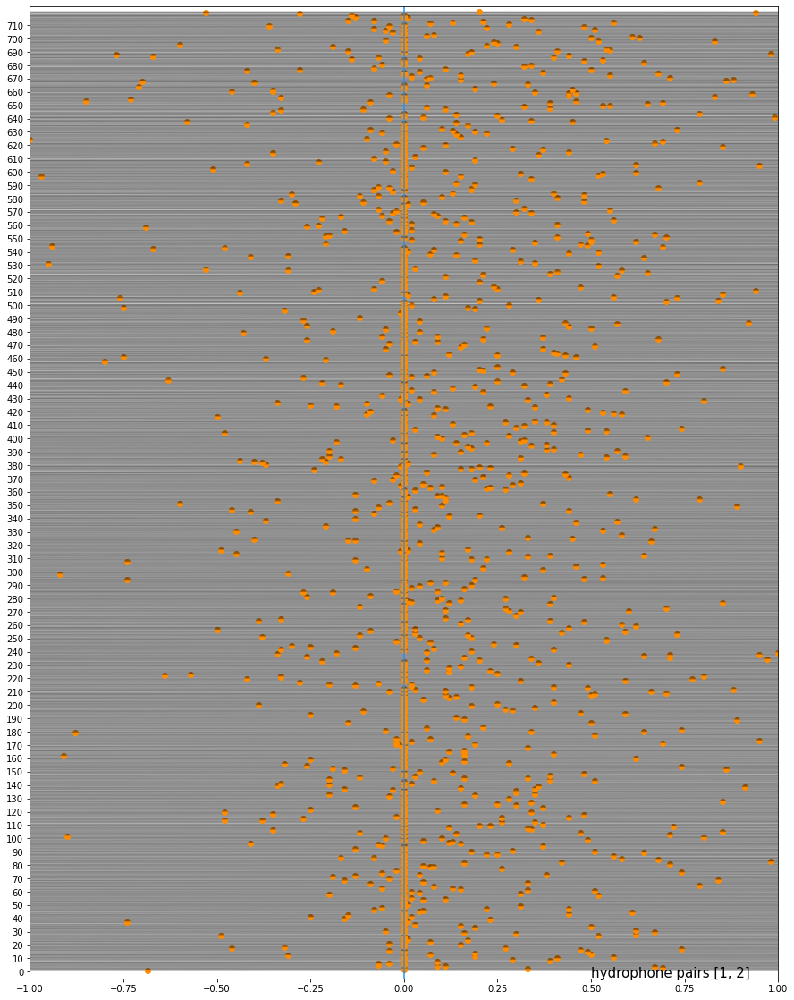

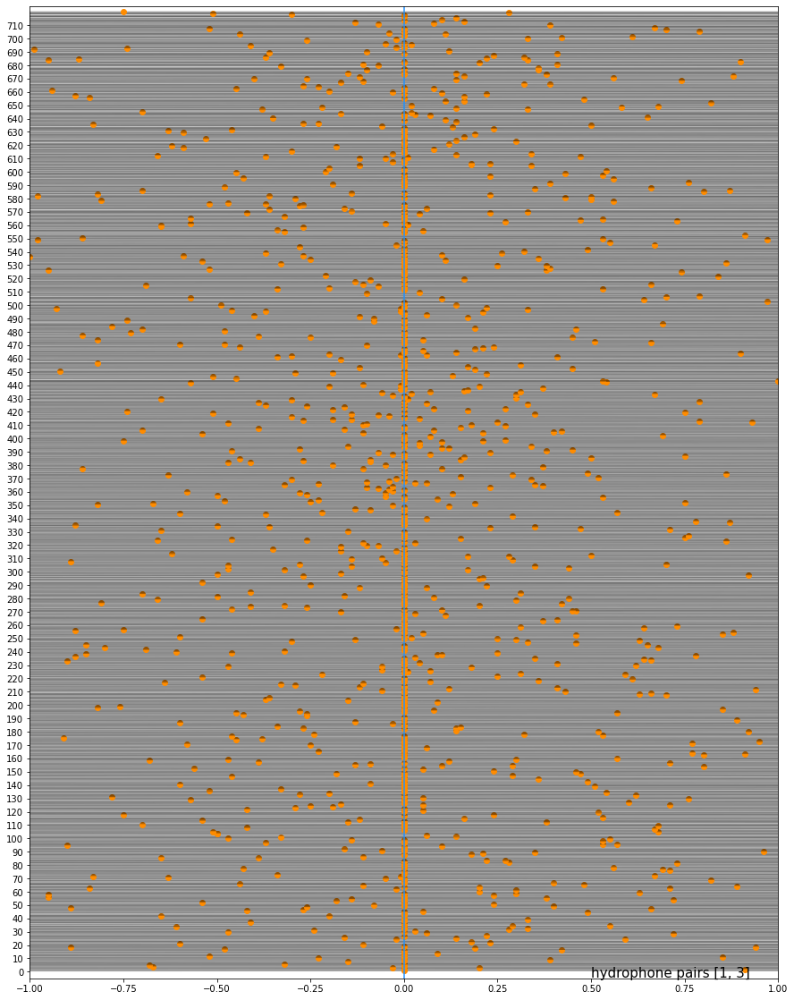

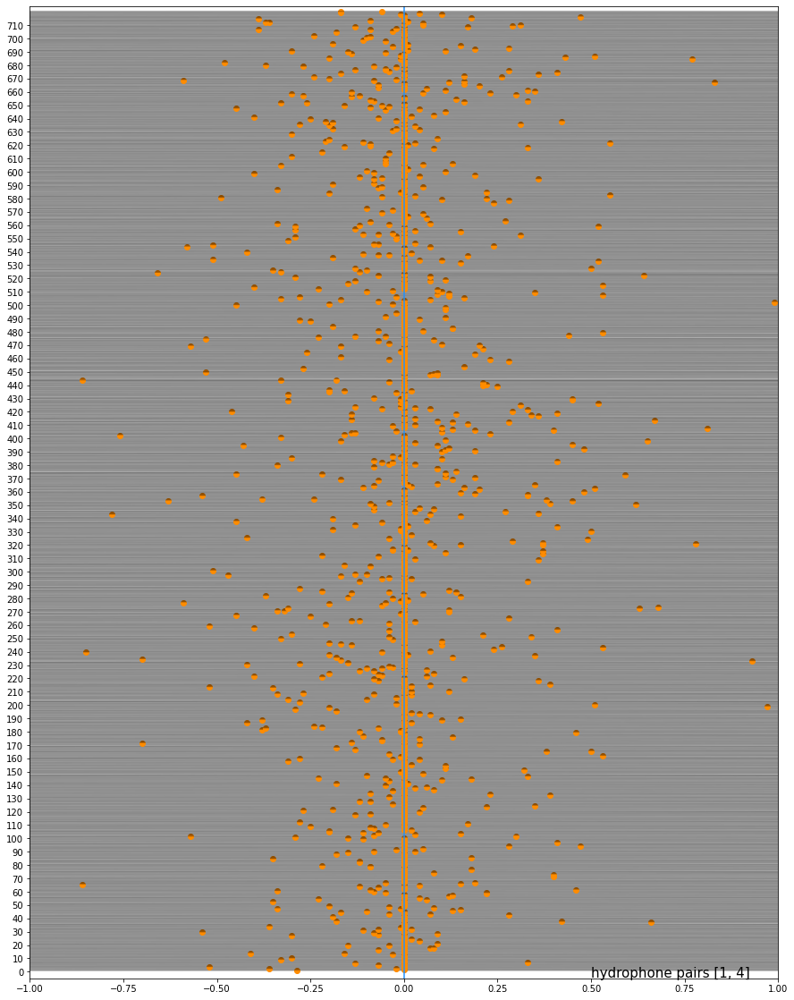

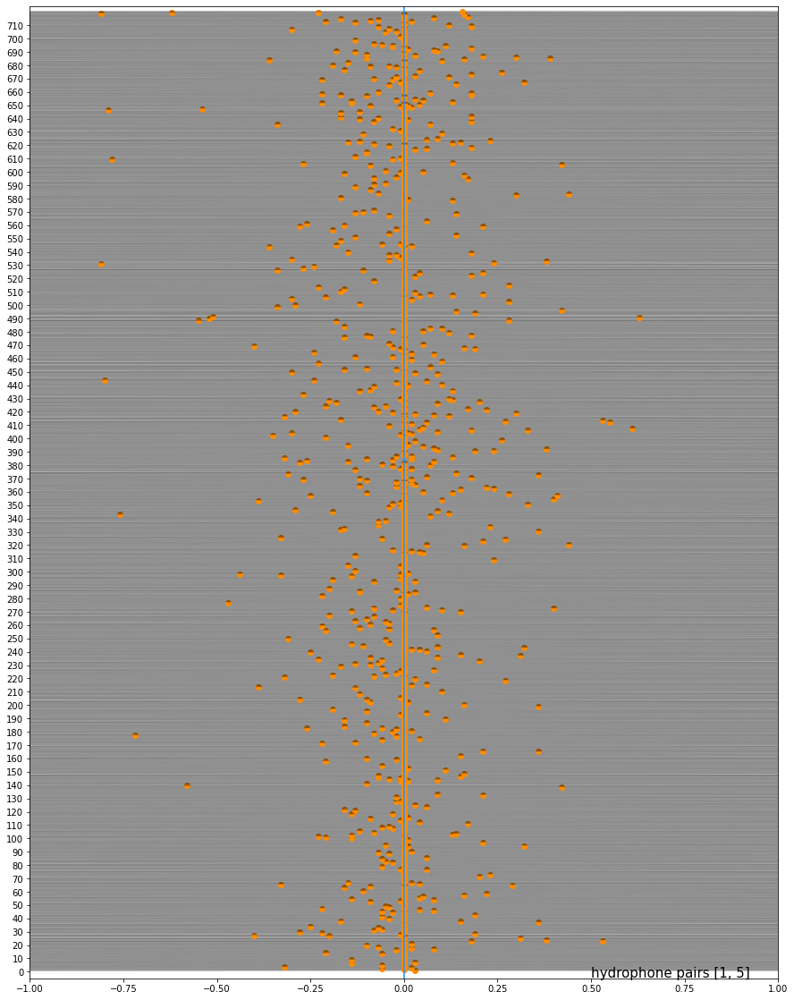

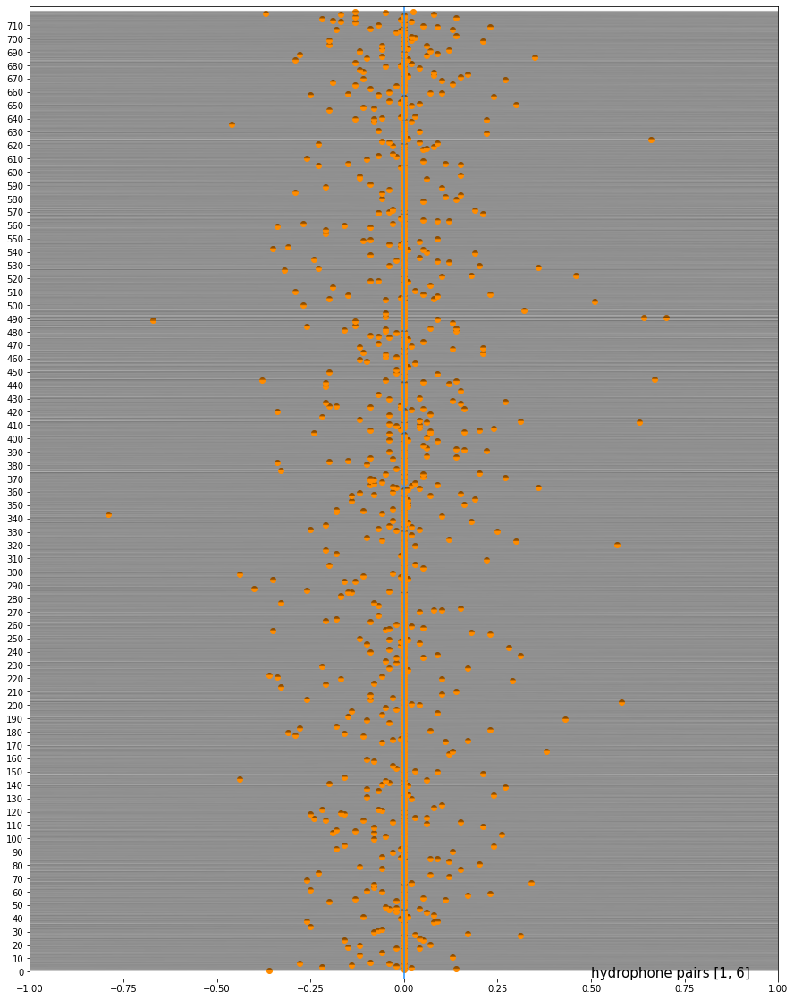

...

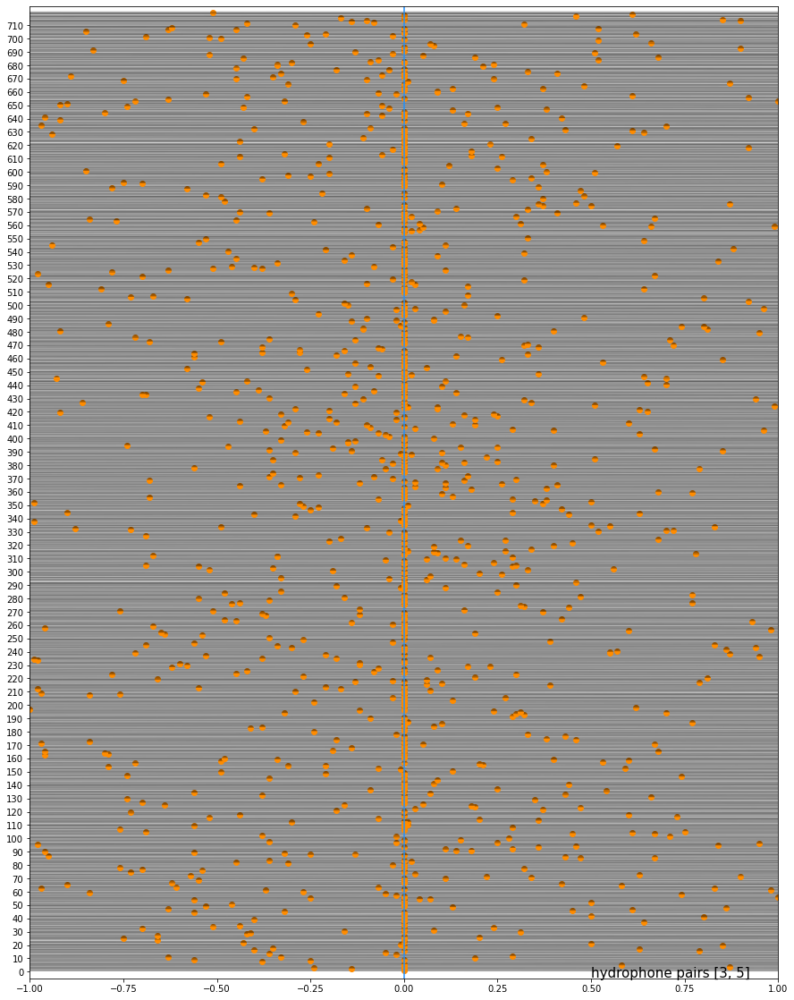

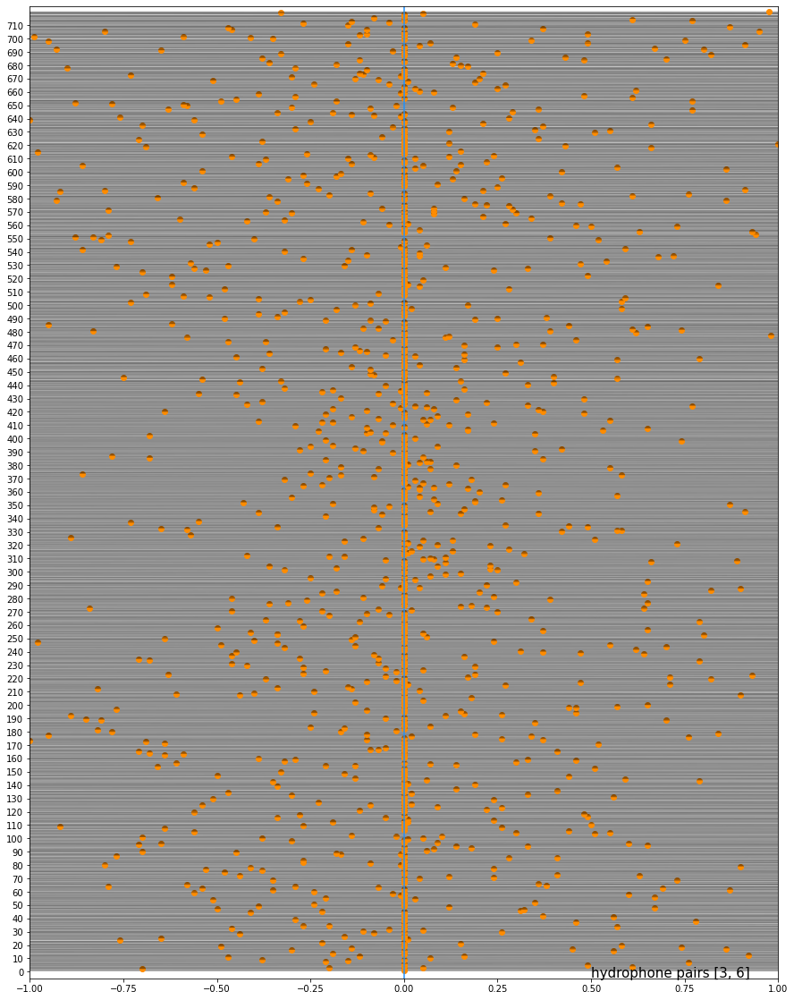

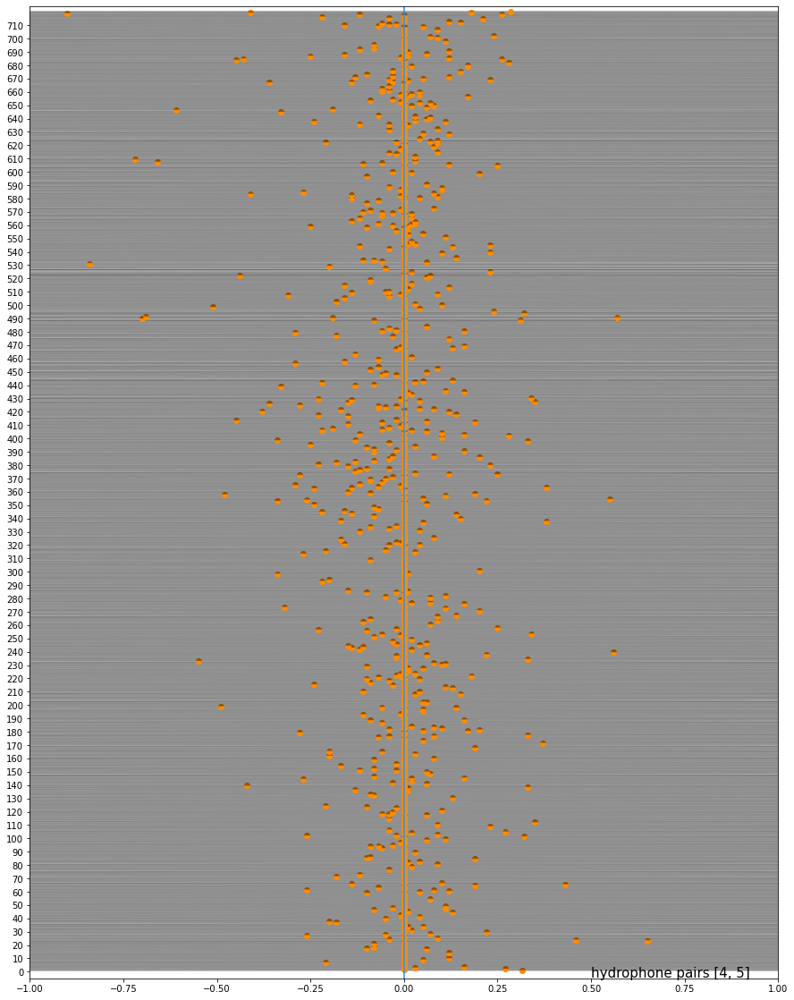

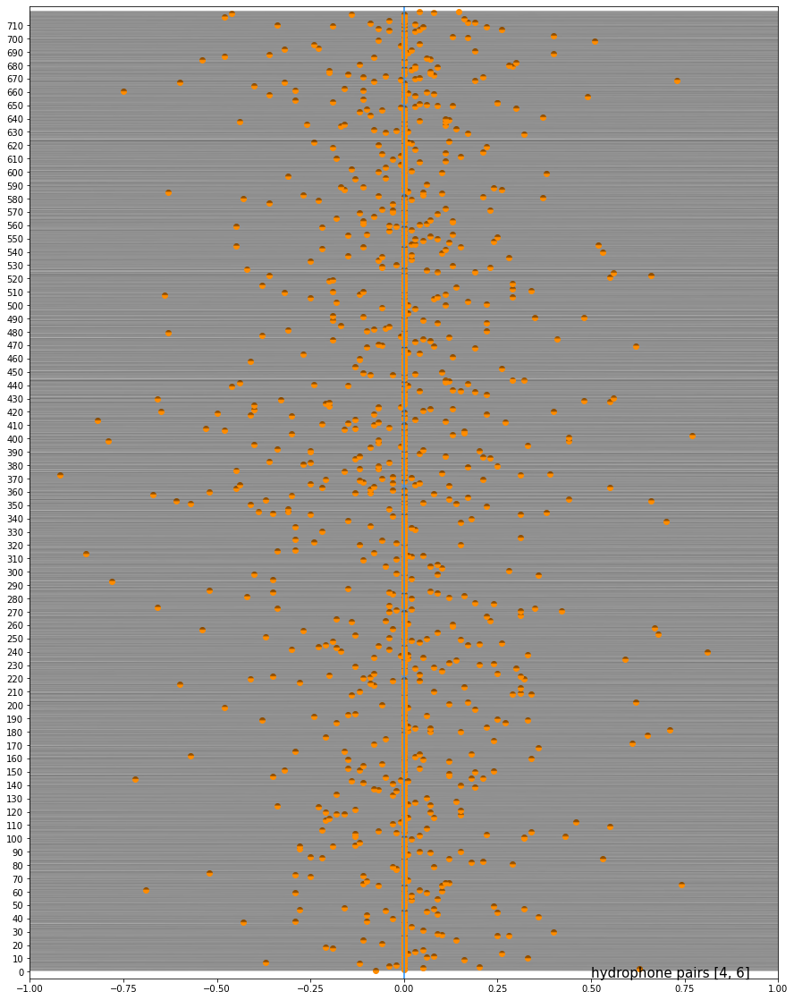

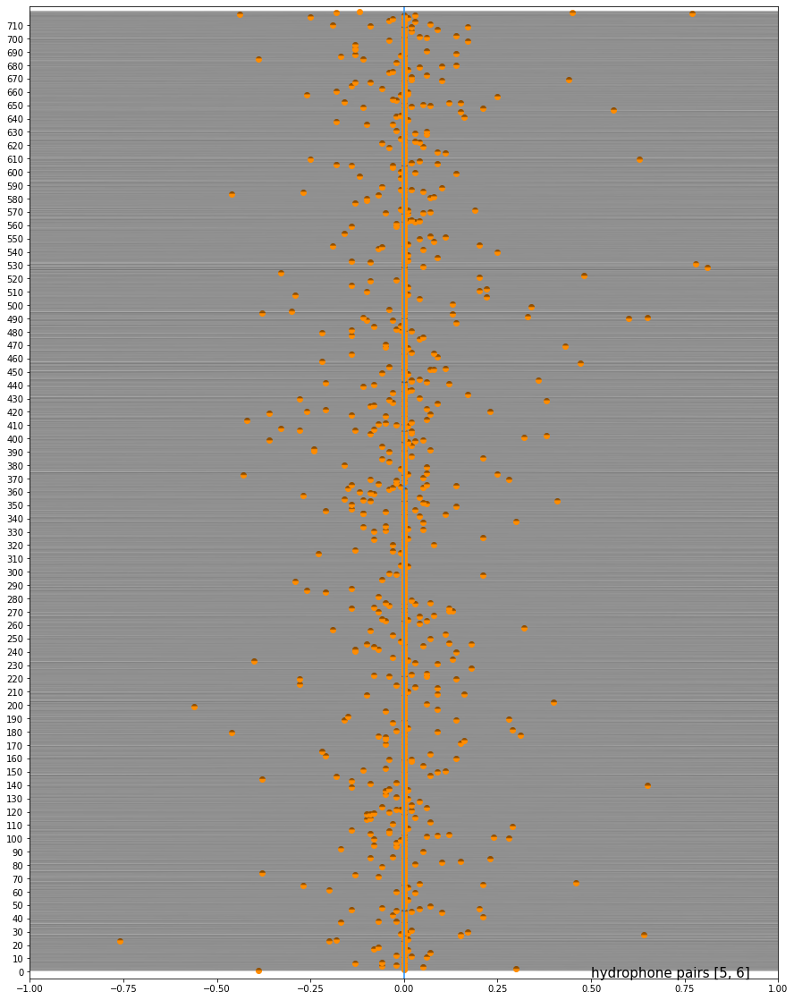

In [92]:
for pairs in hydrophone_pairs:
    fig, ax = plt.subplots(figsize=(15, 20))
    h1, h2 = pairs
    data = cc_df[(cc_df.h1_index==h1) & (cc_df.h2_index==h2)]

    for n, cc in enumerate(data.cc_estimator_normed.values):
        n = n * 0.5
        x = np.linspace(-5, 5, cc.shape[0])
        # ax.plot(x, (cc*10+n), color='black', alpha=0.25)
        ax.plot(x, (cc*1+n), color='black', alpha=0.25)
        ax.plot((x[np.argmax(cc)],), (cc.max()+n,), marker='o', color='darkorange')

    ax.plot([0, 0], [-5, n+5], color='dodgerblue')
    ax.set_ylim(-5, n+5)
    ax.set_yticks(np.arange(0, n, 10))
    # ax.set_yticklabels(data.window_starttime[::19][:-1])
    ax.set_xlim(-1, 1)
    
    ax.text(s='hydrophone pairs {pairs}'.format(pairs=str([p+1 for p in pairs]))
            ,x=0.5, y=-4, fontsize=15 )